In [1]:
import collections
import sys
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.transforms as mtrans
import matplotlib.patches as mpatches
import numpy as np
import pandas as pd
from skimage import exposure
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import cv2
fontprops = fm.FontProperties(size=34)
from sklearn.neighbors import NearestNeighbors
from skimage import color, measure, filters
import seaborn as sns
from matplotlib.colors import ListedColormap
import os
import skimage
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from skimage import filters
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import ImageGrid
from skimage.filters import gaussian
from skimage.filters.rank import median
from skimage.morphology import disk, ball
from collections import defaultdict


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

In [4]:
from config import *
import my_io as io

# Import metadata information

In [5]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [6]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [7]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


# Analysis

In [8]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8a', 'Col1+SMA']

In [9]:
DEFAULT_CHANNELS = (1, 2, 3, 4)

RGB_MAP = {
    1: {
        'rgb': np.array([255, 0, 255]),
        'range': [0,255]
    },
    2: {
        'rgb': np.array([0,255,0]),
        'range': [0,255]
    },
    3: {
        'rgb': np.array([0,255,255]),
        'range': [0,255]
    },
    4: {
        'rgb': np.array([255, 204, 51]),
        'range': [0,255]
    }
}

def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1,dim2,_ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel-1] / vmax) / \
            ((rgb_map[channel]['range'][1] - rgb_map[channel]['range'][0]) / 255) + \
            rgb_map[channel]['range'][0] / 255
        x = np.where(x > 1., 1., x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]['rgb']).reshape(dim1,dim2, 3),
            dtype=int)
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im


def one_channel(t, channel, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1, dim2, _ = t.shape
    colored_channels = []
    x = (t[:, :, 0] / vmax) / (
        (rgb_map[channel]["range"][1] - rgb_map[channel]["range"][0]) / 255
    ) + rgb_map[channel]["range"][0] / 255
    x = np.where(x > 1.0, 1.0, x)
    x_rgb = np.array(
        np.outer(x, rgb_map[channel]["rgb"]).reshape(dim1, dim2, 3), dtype=int
    )
    colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

### Morphology

from skimage.morphology import square, disk
from skimage import morphology 

def get_binary(image):
    blur = cv2.GaussianBlur(image, (9,9), 5)
    th = filters.threshold_otsu(blur)
    binary = blur >= th
    binary = morphology.remove_small_objects(binary, 500)
    binary = morphology.dilation(binary, square(5))
    binary = morphology.closing(binary, disk(5))
    binary = morphology.remove_small_holes(binary, 1000)
    return blur, binary

def myround(x, base=5):
    return base * round(x/base)

C:\Users\thu71\AppData\Local\Temp/ipykernel_113916/399588213.py:68: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig(data_figure / 'border' / f'{dataset}.png', bbox_inches='tight')
C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.canvas.print_figure(bytes_io, **kw)


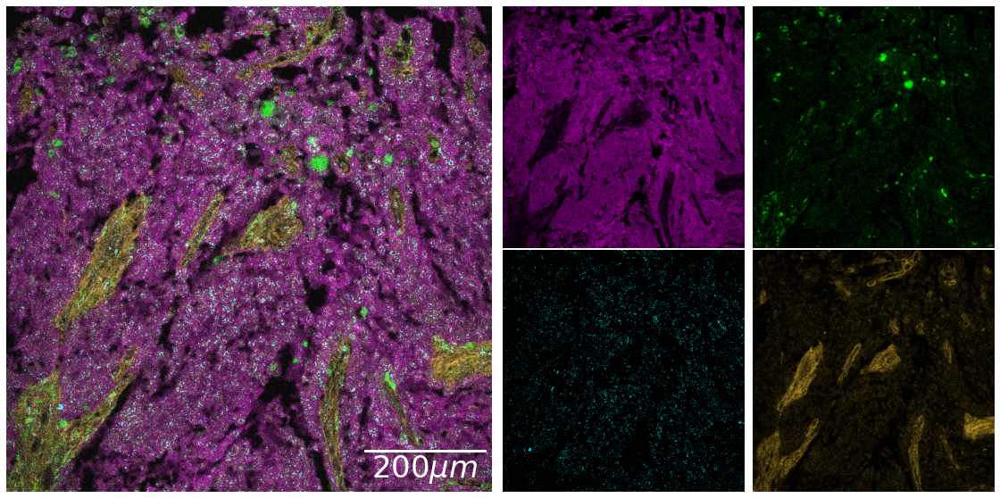

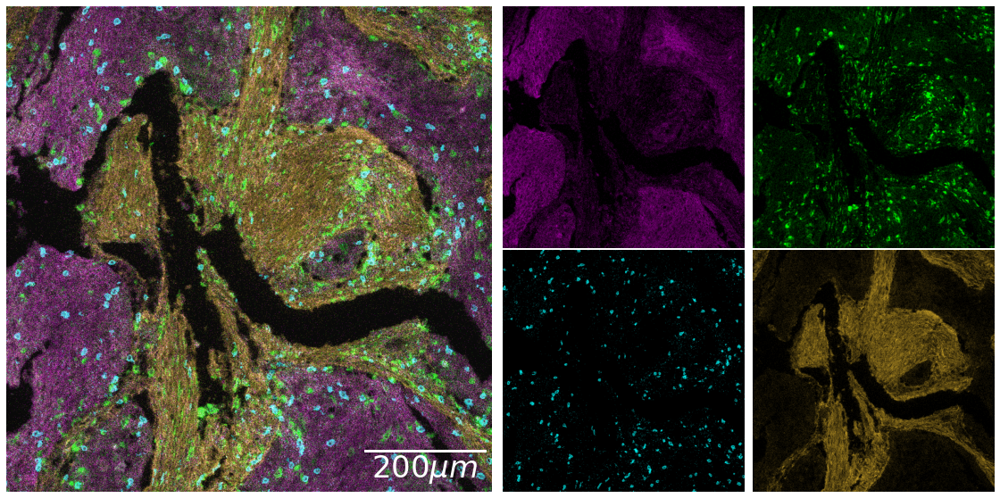

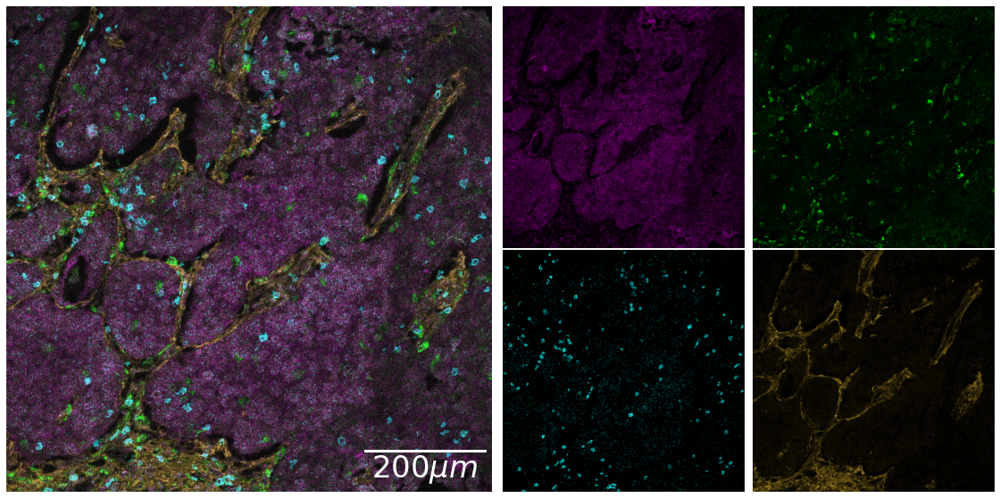

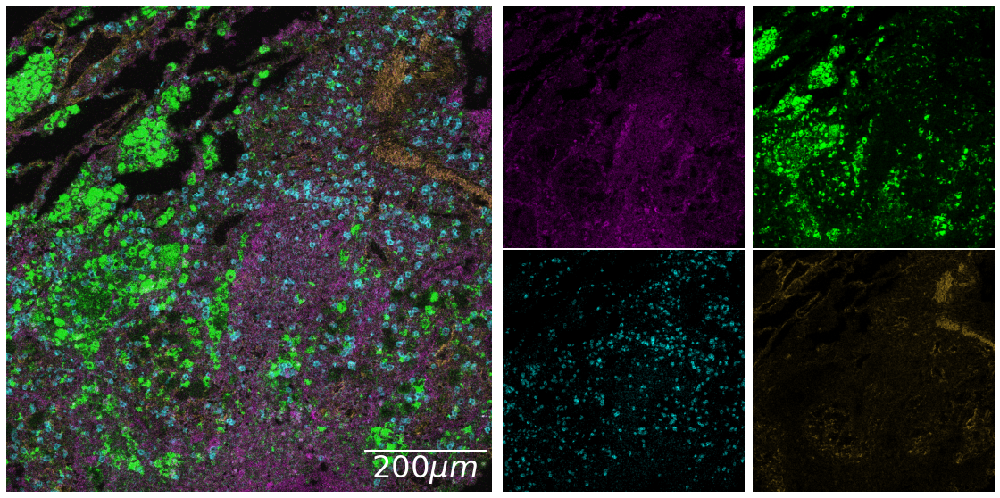

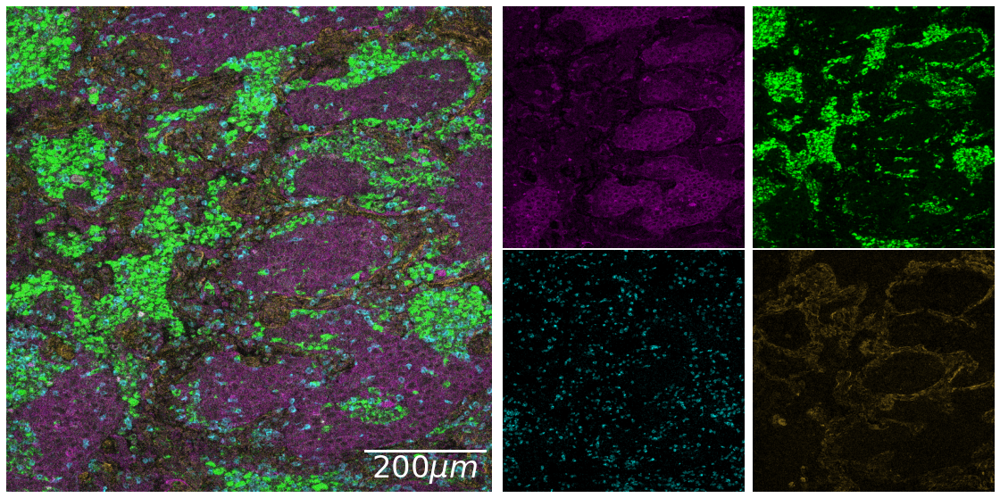

...

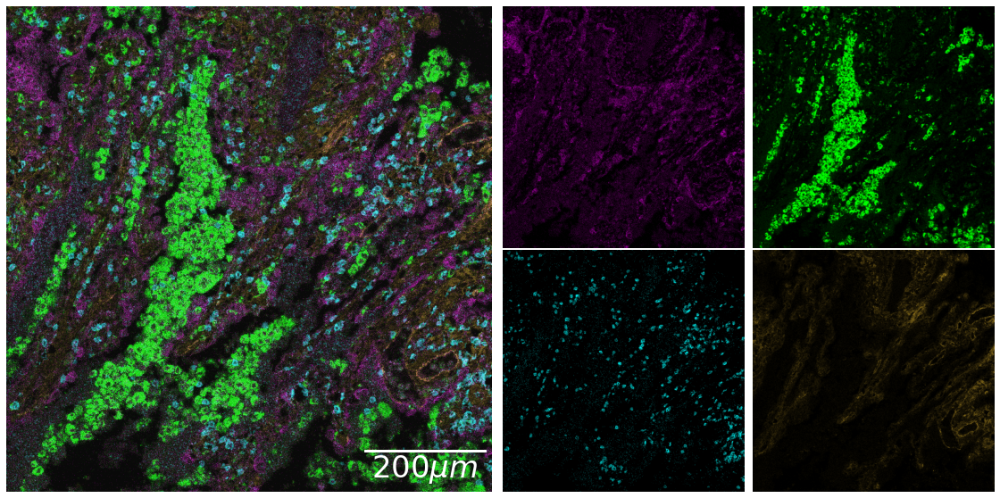

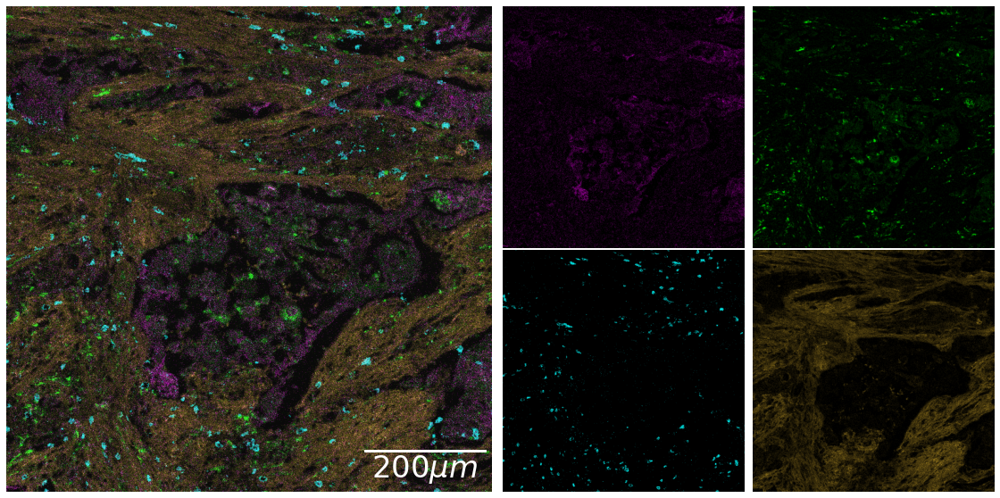

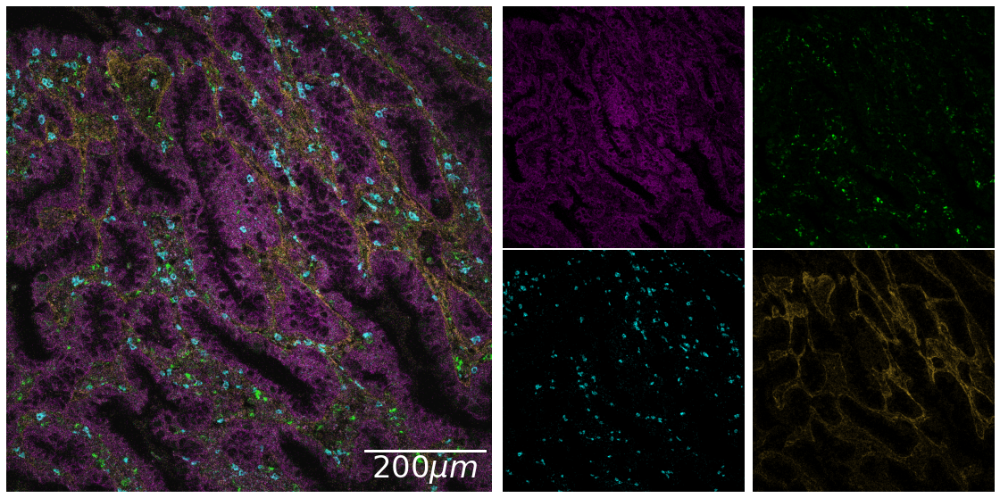

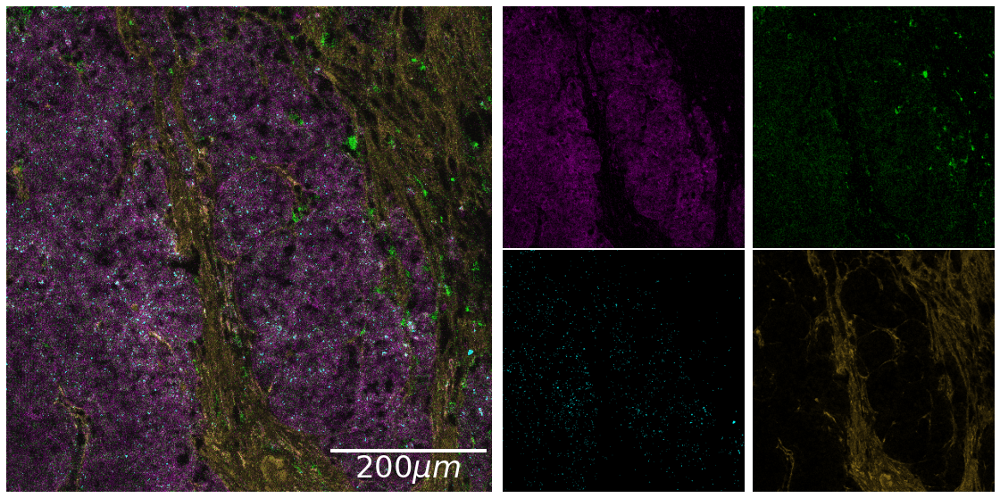

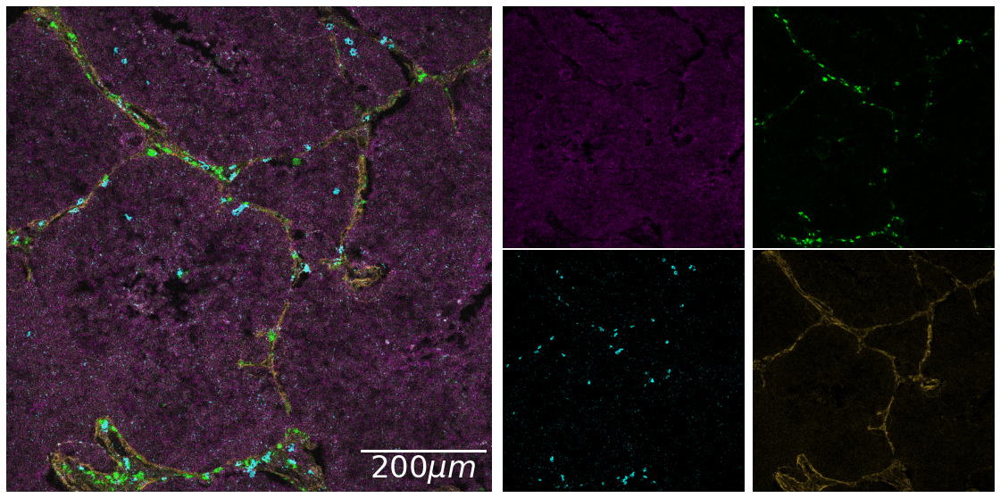

In [10]:
rgb = np.array([item['rgb'] for item in RGB_MAP.values()])
mycmap = ListedColormap(rgb/255)
masks = {}

for dataset in datasets:
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
#     p2, p98 = np.percentile(imgs, (20.0, 99.0))
    min_shape = min(imgs[0].shape[0], imgs[0].shape[1])
    min_shape = myround(min_shape, base=25)

    imgs_list = []
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            if marker == 'CD8a':
                img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0., 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    data = np.stack(imgs_list, axis=2)

    # Show combined for last
    img_rgb = convert_to_rgb(data, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP)

    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]
    
    # Plot multiplex image
    fig = plt.figure(constrained_layout=True, figsize=(20,10))
    gs = plt.GridSpec(2, 4, hspace=0.01, wspace=0.01)
    ax = fig.add_subplot(gs[:2, :2])
    ax.axis('off')
    ax.imshow(avg_img, cmap = plt.get_cmap('gray'), alpha = 0.8)
    ax.imshow(img_rgb, alpha=0.8)
#     patches =[mpatches.Patch(color=RGB_MAP[i]['rgb']/255.0,label=labels[i-1]) for i in DEFAULT_CHANNELS]
#     ax.legend(handles=patches, bbox_to_anchor=(0,0), loc='lower right', borderaxespad=0., fontsize=10)
    # Add scale bar
    scalebar = AnchoredSizeBar(ax.transData,
                           200, r'$200  \mu m$', 'lower right', 
                           pad=0.1,
                           color='white',
                           frameon=False,
                           size_vertical=3,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    
    ax1 = fig.add_subplot(gs[0,2])
    ax1.imshow(one_channel(data[:,:,0][:,:,np.newaxis], 1))
    ax1.axis('off')
    
    ax2 = fig.add_subplot(gs[0,3])
    ax2.imshow(one_channel(data[:,:,1][:,:,np.newaxis], 2))
    ax2.axis('off')
    
    ax3 = fig.add_subplot(gs[1,2])
    ax3.imshow(one_channel(data[:,:,2][:,:,np.newaxis], 3))
    ax3.axis('off')
    
    ax4 = fig.add_subplot(gs[1,3])
    ax4.imshow(one_channel(data[:,:,3][:,:,np.newaxis], 4))
    ax4.axis('off')
    
    fig.savefig(data_figure / 'border' / f'{dataset}.png', bbox_inches='tight')
        
plt.show()

# Cell neighborhood analysis

In [11]:
import networkx as nx

def read_cell_mask(ROI: str):
    """Read all image from one ROI"""
    dir_ = data_figure / 'mask_DL'

    # Get images in directory
    dirpath, _, filenames = next(os.walk(dir_))
    for name in filenames:
        if 'both' in name:
            continue
        elif ROI in name and 'cyto' in name:
            mask_name = name
    mask = skimage.io.imread(os.path.join(dirpath, mask_name))
    return mask

def get_cell_expression_level_mean(imgs_list, labels, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for idx, img in enumerate(imgs_list):
        exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

        df = exp_prop.rename(columns = {'mean_intensity': labels[idx]}, errors = 'raise')
        df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp

def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],"b-", color='red', alpha=1, lw=1, zorder=0)

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='sandybrown', linewidths=2, ax=ax)
    
def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels)+1)])
    
    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    index_low = (df < 0).all(axis=1)
    cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

def replace_with_dict(ar, dic):
    dic[0] = np.nan
    
    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks,ar)]

def myround(x, base=5):
    return base * round(x/base)

In [12]:
from collections import defaultdict
from numpy.lib.stride_tricks import as_strided

def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][1:]   # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                'count': counts[idx], 
                'avg_distance': np.mean(nei_distance[np.where(nei_class == c)])
            }
    return node_nei_info
                             
def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X//n
    return dict(zip(nodes, patches))

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix

def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)['count']
    patch_matrix = patch_matrix
    return patch_matrix

def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)['count']
    return count

def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')
    
def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')

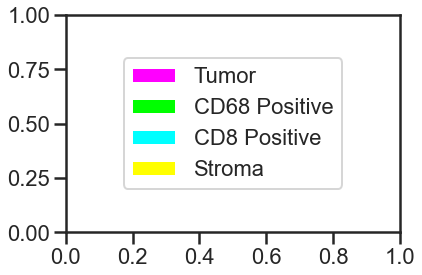

In [95]:
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

legend_elements = [Patch(facecolor=[255/255,0,255/255], 
                         label='Tumor'),
                   Patch(facecolor=[0, 1, 0], 
                         label='CD68 Positive'),
                   Patch(facecolor=[0, 1, 1], 
                         label='CD8 Positive'),
                   Patch(facecolor=[1, 1, 0], 
                         label='Stroma')
                  ]

# Create the figure
fig, ax = plt.subplots()
ax.legend(handles=legend_elements, loc='center')

plt.show()

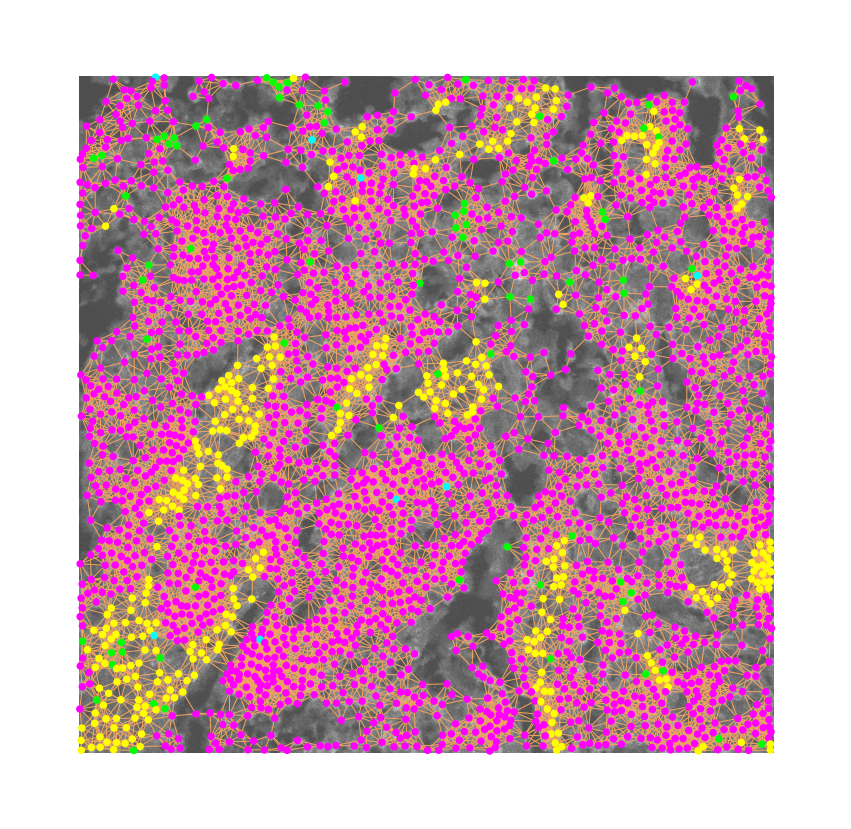

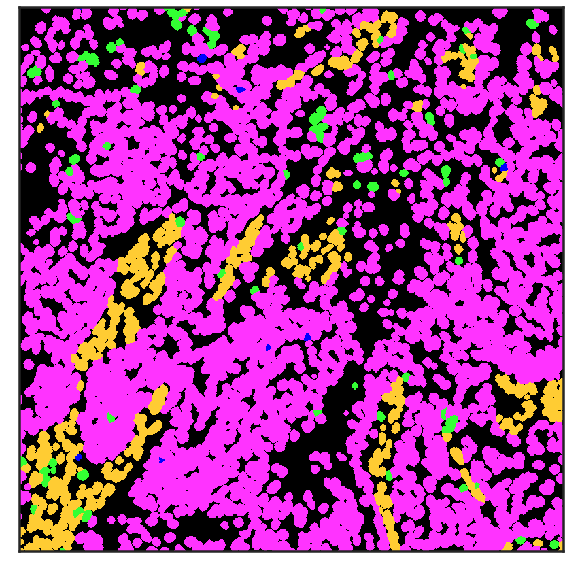

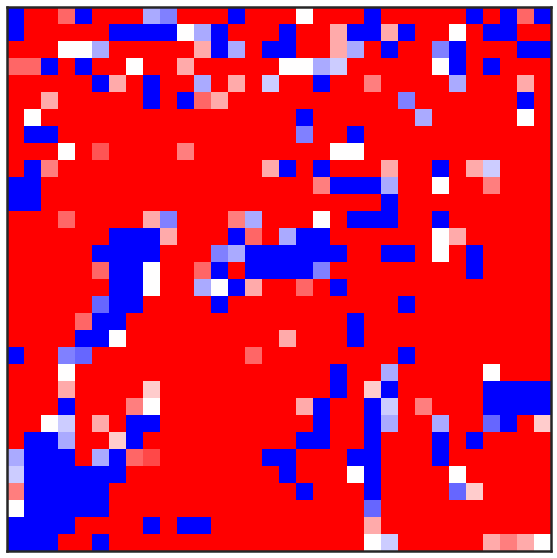

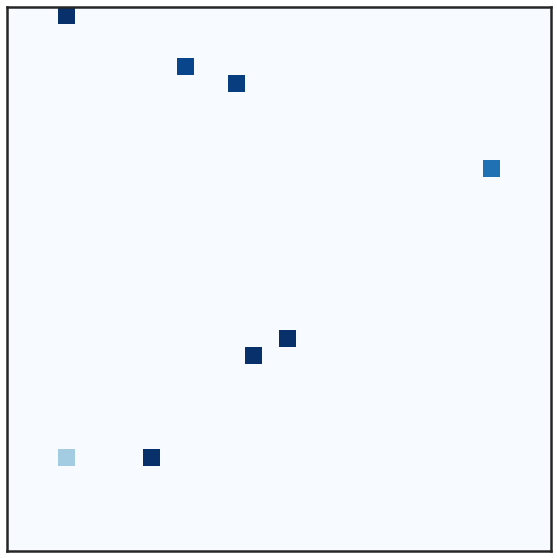

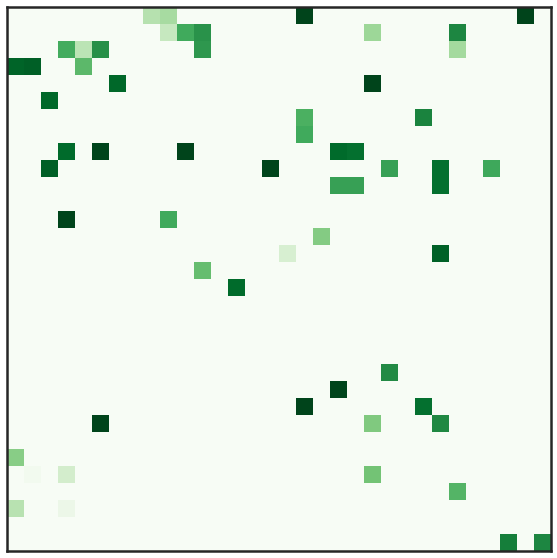

...

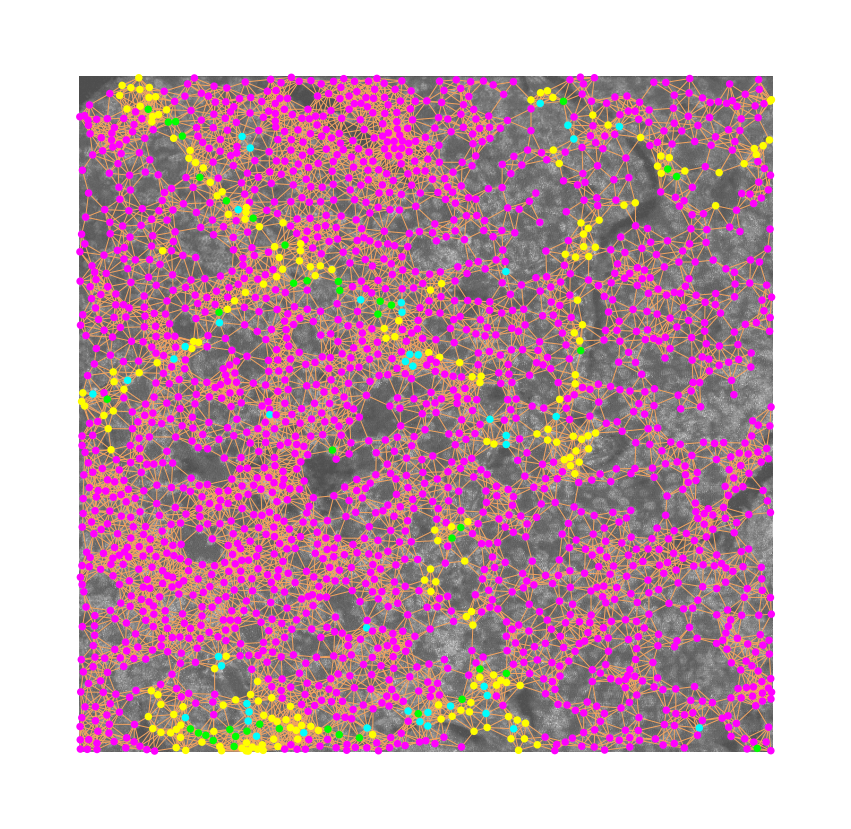

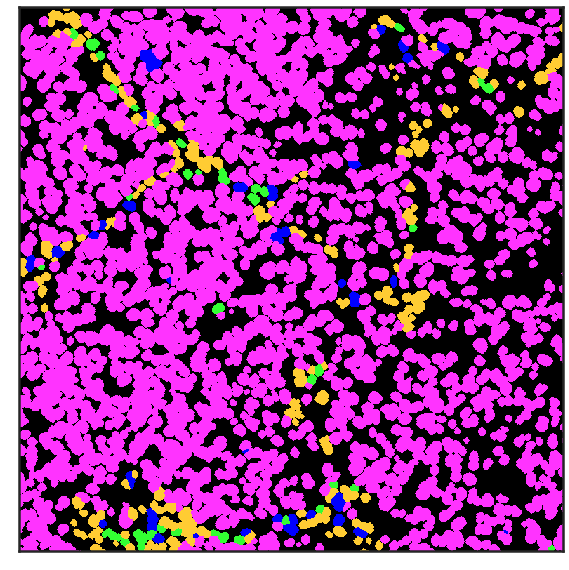

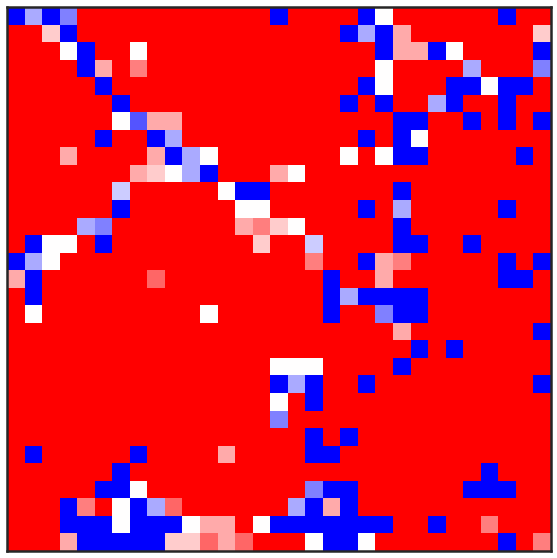

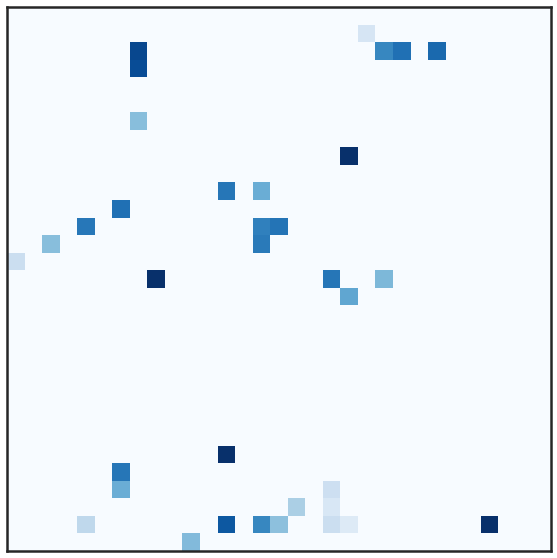

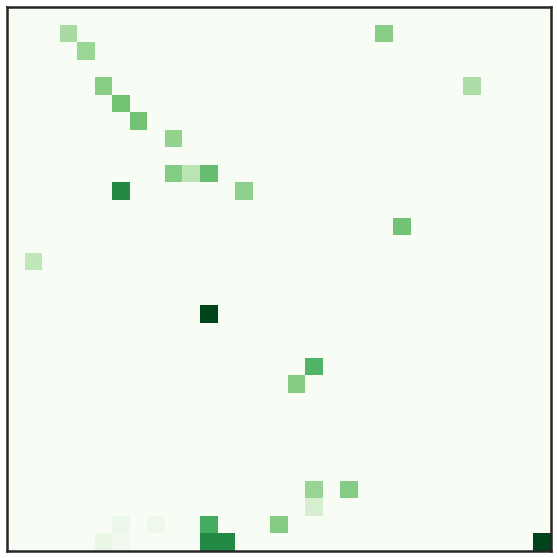

In [53]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8a', 'Col1+SMA']
rgb = np.array([[255,0,255], [0,255,0], [0,255,255], [255,255,0], [160,160,160]])
mycmap = ListedColormap(rgb/255)
rgb2 = np.array([[255,51,255], [51,255,51], [0,0,255], [255,204,51], [160,160,160]])
mycmap2 = ListedColormap(rgb2/255)
scores = defaultdict(list)
scores_count = defaultdict(list)
show=True
n = 25

for dataset in datasets:

    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]
    
    imgs_list = []
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            if marker == 'CD8a':
                img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

    # Get cell neighbors analysis
    distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
    df = get_cell_expression_level_mean(imgs_list, labels, cell_mask)
    df['ECA+PanK'] = df['ECA+PanK'] * 0.6
    node_class, node_colors = get_cell_color(df, labels, rgb)
    
    node_class, _ = get_cell_color(df, labels, rgb)
    neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
    node_patch = get_node_patch(X, node_class, n)
    
    #Plot proximity map
    fig, ax = plt.subplots(figsize=(15,15))
    ax.axis('off')
    top, right = avg_img.shape
    ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
    plot_nn(X, graph, node_colors, ax)
    ax.invert_yaxis()
    scalebar = AnchoredSizeBar(ax.transData,
                           200, r'$200  \mu m$', 'lower right', 
                           pad=0.1,
                           color='white',
                           frameon=False,
                           size_vertical=3,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    fig.savefig(data_figure / 'border' / f'cell_graph_{dataset}.png', bbox_inches='tight')
    
    #Plot cell mask
    img = replace_with_dict(cell_mask , node_class)
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(img, cmap=mycmap2, interpolation='None', vmin=0, vmax=5)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('black')
    fig.savefig(data_figure / 'border' / f'cell_mask_{dataset}.png', bbox_inches='tight')
    
    
    # Get Tumor and Stroma island 
    
    tumor = patch_count(0, node_class, node_patch, n, avg_img.shape)
    inegatif = patch_count(1, node_class, node_patch, n, avg_img.shape)
    ipositif = patch_count(2, node_class, node_patch, n, avg_img.shape)
    stroma = patch_count(3, node_class, node_patch, n, avg_img.shape)
    
    total = [patch_count(i, node_class, node_patch, n, avg_img.shape)  for i in range(5)]
    total = np.sum(total, axis=(0))
    P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total!=0)
    P_ip = np.divide(ipositif, total, out=np.zeros_like(total), where=total!=0)
    P_in = np.divide(inegatif, total, out=np.zeros_like(total), where=total!=0)
    P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total!=0)

    if show:
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(P_tumor, vmin=0, vmax=1, cmap='bwr')
        ax.tick_params(axis=u'both', which=u'both',length=0, labelbottom=False, labelleft=False)
        fig.savefig(data_figure / 'border' / f'tumor_stroma_{dataset}.png', bbox_inches='tight')
        plt.show()

    # IP to tumor
    ip_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_s_int = patch_count_neighbor(2, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_ip_int = patch_count_neighbor(2, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    ip_int_total = np.sum(ip_int_total, axis=(0))
    P_ip_t = np.divide(ip_t_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_s = np.divide(ip_s_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_ip = np.divide(ip_ip_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)

    if show:
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(P_ip_t, vmin=0, vmax=1, cmap='Blues')
        ax.tick_params(axis=u'both', which=u'both',length=0, labelbottom=False, labelleft=False)
        
        fig.savefig(data_figure / 'border' / f'int_imp_{dataset}.png', bbox_inches='tight')
        plt.show()
    
    # IN to tumor
    in_t_int = patch_count_neighbor(1, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_ip_int = patch_count_neighbor(1, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_s_int = patch_count_neighbor(1, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_int_total = [patch_count_neighbor(1, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    in_int_total = np.sum(in_int_total, axis=(0))
    P_in_t = np.divide(in_t_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_s = np.divide(in_s_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_in = np.divide(in_ip_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)

    if show:
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(P_in_t, vmin=0, vmax=1, cmap='Greens')
        ax.tick_params(axis=u'both', which=u'both',length=0, labelbottom=False, labelleft=False)
        
        fig.savefig(data_figure / 'border' / f'int_imn_{dataset}.png', bbox_inches='tight')
        plt.show()
        
    scores['Tumor'].append(round(np.mean(P_tumor),4))
    scores['Stroma'].append(round(np.mean(P_stroma),4))
    scores['CD8+'].append(round(np.mean(P_ip),4))
    scores['CD68+'].append(round(np.mean(P_in),4))
    scores['CD8-T'].append(round(np.mean(P_ip_t),4))
    scores['CD8-CD8'].append(round(np.mean(P_ip_ip),4))
    scores['CD8-S'].append(round(np.mean(P_ip_s),4))
    scores['CD68-T'].append(round(np.mean(P_in_t),4))
    scores['CD68-CD68'].append(round(np.mean(P_in_in),4))
    scores['CD68-S'].append(round(np.mean(P_in_s),4))


    scores_count['Tumor-Tumor'].append(count_neighbor(0, 0, neighbor_class, node_class))
    scores_count['Tumor-CD68'].append(count_neighbor(0, 1, neighbor_class, node_class))
    scores_count['Tumor-CD8'].append(count_neighbor(0, 2, neighbor_class, node_class))
    scores_count['Tumor-Stroma'].append(count_neighbor(0, 3, neighbor_class, node_class))
    scores_count['CD68-CD68'].append(count_neighbor(1, 1, neighbor_class, node_class))
    scores_count['CD68-CD8'].append(count_neighbor(1, 2, neighbor_class, node_class))
    scores_count['CD68-Stroma'].append(count_neighbor(1, 3, neighbor_class, node_class))
    scores_count['CD8-CD8'].append(count_neighbor(2, 2, neighbor_class, node_class))
    scores_count['CD8-Stroma'].append(count_neighbor(2, 3, neighbor_class, node_class))
    scores_count['Stroma-Stroma'].append(count_neighbor(3, 3, neighbor_class, node_class))
    
#     scores['Tumor'].append(P_tumor)
#     scores['Stroma'].append(P_stroma)
#     scores['IP'].append(P_ip)
#     scores['IN'].append(P_in)
#     scores['IP_T'].append(P_ip_t)
#     scores['IP_IP'].append(P_ip_ip)
#     scores['IP_S'].append(P_ip_s)
#     scores['IN_T'].append(P_in_t)
#     scores['IN_IN'].append(P_in_in)
#     scores['IN_S'].append(P_in_s)

plt.show()

In [54]:
# scores_mean = defaultdict(list)
# for i, P_tumor in enumerate(scores['Tumor']):
#     P_stroma = scores['Stroma'][i]
#     P_ip = scores['IP'][i]
#     P_in = scores['IN'][i]
#     P_ip_t = scores['IP_T'][i]
#     P_ip_ip = scores['IP_IP'][i]
#     P_ip_s = scores['IP_S'][i]
#     P_in_t = scores['IN_T'][i]
#     P_in_in = scores['IN_IN'][i]
#     P_in_s = scores['IN_S'][i]
    
#     mask_tumor = P_tumor > 0
#     mask_stroma = P_stroma > 0
    
#     P_ip_t = np.ma.array(P_ip_t, mask=mask_tumor).mean()
#     P_ip_s = np.ma.array(P_ip_s, mask=mask_stroma).mean()
#     P_in_t = np.ma.array(P_in_t, mask=mask_tumor).mean()
#     P_in_s = np.ma.array(P_in_s, mask=mask_stroma).mean()
    
#     scores_mean['Tumor'].append(round(np.mean(P_tumor),4))
#     scores_mean['Stroma'].append(round(np.mean(P_stroma),4))
#     scores_mean['IP'].append(round(np.mean(P_ip),4))
#     scores_mean['IN'].append(round(np.mean(P_in),4))
#     scores_mean['IP_T'].append(round(np.mean(P_ip_t),4))
#     scores_mean['IP_IP'].append(round(np.mean(P_ip_ip),4))
#     scores_mean['IP_S'].append(round(np.mean(P_ip_s),4))
#     scores_mean['IN_T'].append(round(np.mean(P_in_t),4))
#     scores_mean['IN_IN'].append(round(np.mean(P_in_in),4))
#     scores_mean['IN_S'].append(round(np.mean(P_in_s),4))

In [55]:
scores

defaultdict(list,
            {'Tumor': [0.7808,
              0.3335,
              0.6776,
              0.251,
              0.2997,
              0.4331,
              0.2044,
              0.2703,
              0.217,
              0.2098,
              0.0955,
              0.5114,
              0.6521,
              0.8312],
             'Stroma': [0.1222,
              0.3743,
              0.1491,
              0.1695,
              0.2393,
              0.2247,
              0.2297,
              0.2873,
              0.1978,
              0.1641,
              0.3996,
              0.213,
              0.0871,
              0.0833],
             'CD8+': [0.0022,
              0.0404,
              0.0464,
              0.1392,
              0.1056,
              0.0468,
              0.3787,
              0.0377,
              0.3786,
              0.1357,
              0.0552,
              0.0568,
              0.0025,
              0.0183],
             'CD68+': [0.0274,


# Heatmap Viz

## Count

In [56]:
df = pd.DataFrame(scores_count, index=datasets)
df.index = [index[-2:] for index in df.index]
df

,Tumor-Tumor,Tumor-CD68,Tumor-CD8,Tumor-Stroma,CD68-CD68,CD68-CD8,CD68-Stroma,CD8-CD8,CD8-Stroma,Stroma-Stroma
B1,27900,512,103,1879,118,3,204,0,12,2916
B3,7614,1357,662,510,1808,407,2405,104,519,16092
B5,20864,1261,773,993,262,150,358,206,390,2350
C6,18282,7819,4674,2585,18848,4766,2937,5074,2590,4466
D7,8968,3783,2149,2844,16164,3286,5466,1948,3191,11564
D9,10498,1368,467,586,1796,160,252,100,204,1540
E1,6826,1922,5037,801,3648,7029,2986,18588,6338,11542
B6,3844,717,259,996,610,108,424,106,329,2830
F3,8624,1866,4455,796,8718,12872,6640,30628,12300,14262
F2,3434,1954,1177,1289,5902,1370,1471,1854,1380,2478


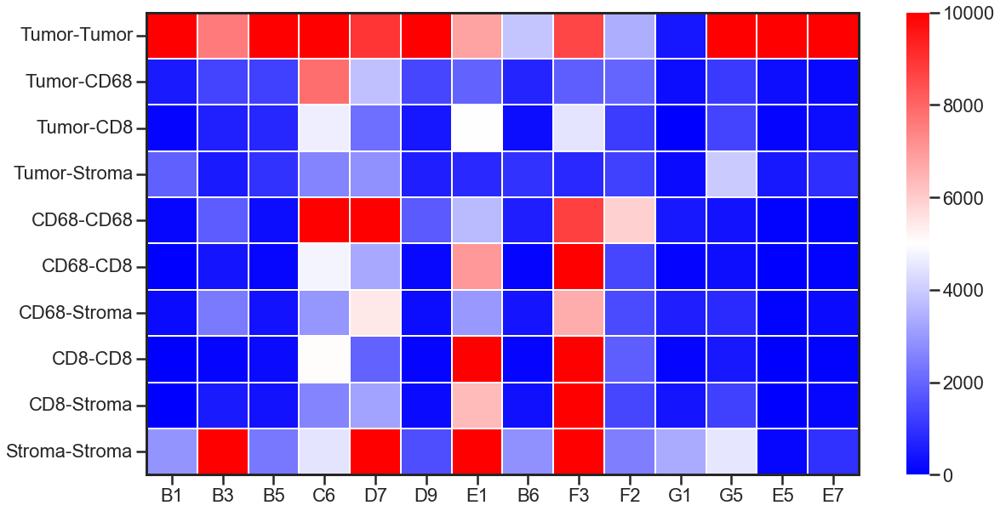

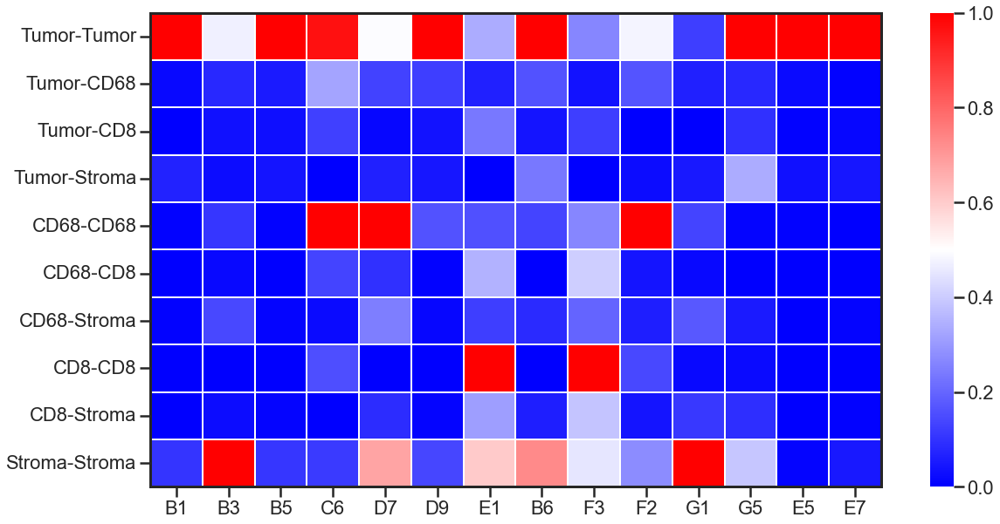

In [57]:
# Clustermap
from matplotlib.colors import LogNorm

my_cmap = 'bwr'
scale_name = "Score"

sns.set_style("ticks")
sns.set_context("poster")

fig, ax = plt.subplots(figsize=(20,10))
ax = sns.heatmap(
    df.T,
    cbar_kws={"fraction": 0.2},
    cmap=my_cmap,
    linewidth=0.1,
    vmax=10000
#     norm = LogNorm()
)


for _, spine in ax.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

# Scaled
scaler = MinMaxScaler() 
scaled_values = scaler.fit_transform(df.T)
df_scaled = pd.DataFrame(scaled_values.T, index=df.index, columns=df.columns)


# Clustermap
from matplotlib.colors import LogNorm

my_cmap = 'bwr'
scale_name = "Score"

sns.set_style("ticks")
sns.set_context("poster")

fig, ax = plt.subplots(figsize=(20,10))
ax = sns.heatmap(
    df_scaled.T,
    cbar_kws={"fraction": 0.2},
    cmap=my_cmap,
    linewidth=0.1,
#     norm = LogNorm()
)


for _, spine in ax.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

## Proportion

In [58]:
df = pd.DataFrame(scores, index=datasets)
df.index = [index[-2:] for index in df.index]
df

,Tumor,Stroma,CD8+,CD68+,CD8-T,CD8-CD8,CD8-S,CD68-T,CD68-CD68,CD68-S
B1,0.7808,0.1222,0.0022,0.0274,0.0068,0.0000,0.0008,0.0393,0.0078,0.0132
B3,0.3335,0.3743,0.0404,0.1433,0.0512,0.0061,0.0331,0.0877,0.0759,0.1076
B5,0.6776,0.1491,0.0464,0.0702,0.0590,0.0107,0.0275,0.0957,0.0200,0.0300
C6,0.2510,0.1695,0.1392,0.3807,0.0987,0.0860,0.0695,0.1551,0.3196,0.0810
D7,0.2997,0.2393,0.1056,0.3545,0.0872,0.0485,0.0990,0.1100,0.2936,0.1439
D9,0.4331,0.2247,0.0468,0.0767,0.0406,0.0095,0.0256,0.0494,0.0429,0.0267
E1,0.2044,0.2297,0.3787,0.1706,0.1289,0.3178,0.1464,0.0723,0.0975,0.0972
B6,0.2703,0.2873,0.0377,0.1175,0.0268,0.0073,0.0272,0.0683,0.0531,0.0462
F3,0.2170,0.1978,0.3786,0.1979,0.0990,0.3314,0.1726,0.0462,0.1430,0.1306
F2,0.2098,0.1641,0.1357,0.3596,0.0621,0.0696,0.0653,0.1004,0.2732,0.0732


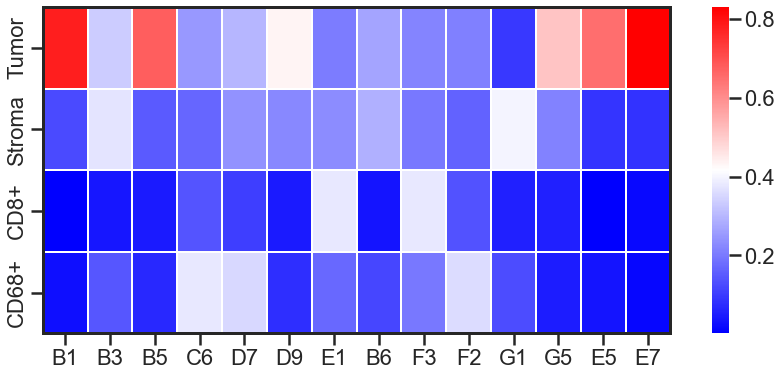

In [59]:
# Clustermap
from matplotlib.colors import LogNorm

my_cmap = 'bwr'
scale_name = "Score"

sns.set_style("ticks")
sns.set_context("poster")

fig, ax = plt.subplots(figsize=(15,6))
ax = sns.heatmap(
    df.iloc[:,:4].T,
    cbar_kws={"fraction": 0.2},
    cmap=my_cmap,
    linewidth=0.1,
#     norm = LogNorm()
)

ax.set_yticklabels(ax.get_yticklabels(), va='center')



for _, spine in ax.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

In [60]:
df.iloc[:,:4]

,Tumor,Stroma,CD8+,CD68+
B1,0.7808,0.1222,0.0022,0.0274
B3,0.3335,0.3743,0.0404,0.1433
B5,0.6776,0.1491,0.0464,0.0702
C6,0.2510,0.1695,0.1392,0.3807
D7,0.2997,0.2393,0.1056,0.3545
D9,0.4331,0.2247,0.0468,0.0767
E1,0.2044,0.2297,0.3787,0.1706
B6,0.2703,0.2873,0.0377,0.1175
F3,0.2170,0.1978,0.3786,0.1979
F2,0.2098,0.1641,0.1357,0.3596


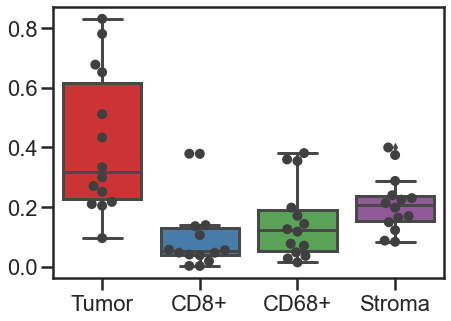

In [63]:
sns.set_style("ticks")
sns.set_context("poster")

fig, ax = plt.subplots(figsize=(7, 5))
ax = sns.boxplot(data=df.iloc[:,:4], palette="Set1", order=['Tumor', 'CD8+', 'CD68+', 'Stroma'])
ax = sns.swarmplot(data=df.iloc[:,:4], color="0.25", size=10, order=['Tumor', 'CD8+', 'CD68+', 'Stroma'])

C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\pandas\util\_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


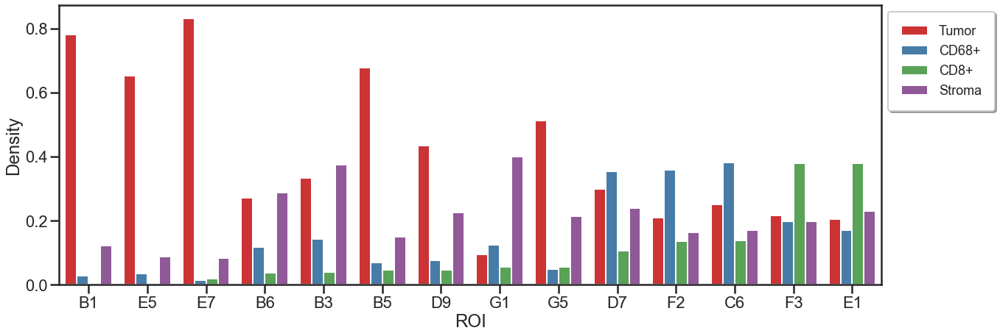

In [85]:
df_subset = df[['Tumor',  'CD68+', 'CD8+', 'Stroma']]
df_subset.sort_values('CD8+', inplace=True)
df_subset = df_subset.melt(var_name='Type', value_name='Density', ignore_index=False)
df_subset.index = df_subset.index.set_names(['ROI'])
df_subset.reset_index(inplace=True)

fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.barplot(data=df_subset, x='ROI' , y='Density', hue='Type', palette="Set1")
ax.legend(
        loc="upper left",
        bbox_to_anchor=(1.0, 1.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=18
    )

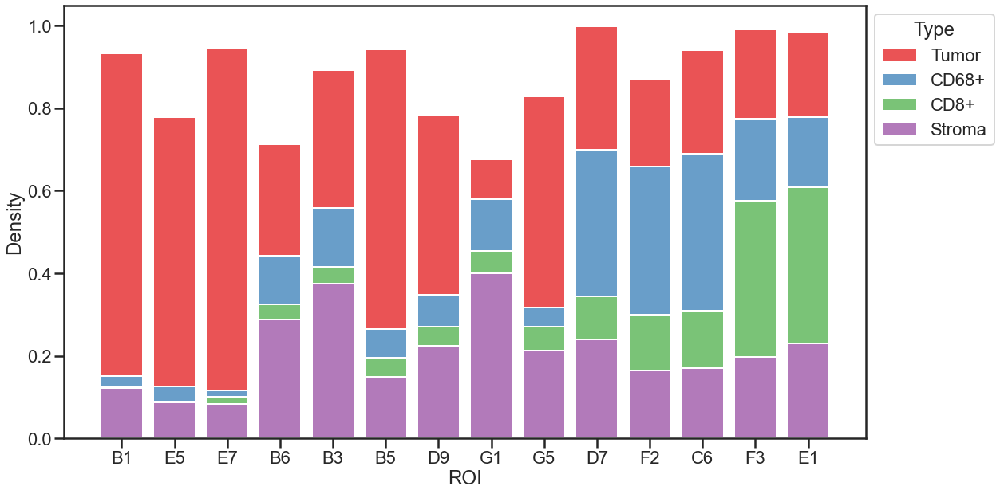

In [86]:
fig, ax = plt.subplots(figsize=(18, 10))
ax = sns.histplot(data=df_subset, x='ROI' , hue='Type', weights='Density',
             multiple='stack', palette='Set1', shrink=0.8)
ax.set_ylabel('Density')
# Fix the legend so it's not on top of the bars.
legend = ax.get_legend()
legend.set_bbox_to_anchor((1, 1))

In [87]:
df_line = df_subset[df_subset.ROI.isin(['B1', 'E7', 'F2', 'D7', 'E1', 'F3'])]

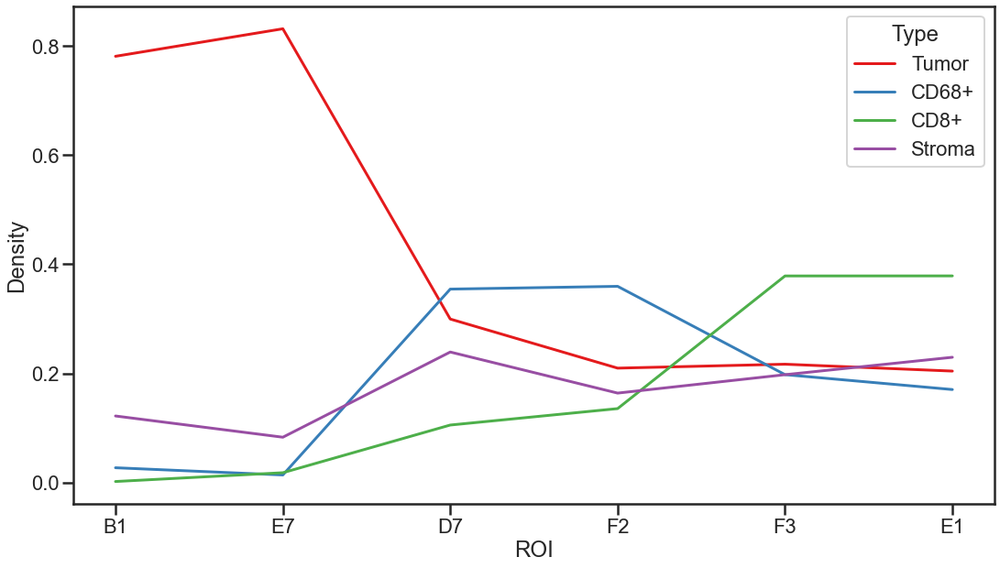

In [88]:
fig, ax = plt.subplots(figsize=(18, 10))
ax = sns.lineplot(data=df_line, x='ROI', y='Density', hue='Type', palette='Set1')
ax.set_ylabel('Density')
# Fix the legend so it's not on top of the bars.
legend = ax.get_legend()
legend.set_bbox_to_anchor((1, 1))

In [89]:
from scipy.interpolate import interp1d

x = df_line[df_line.Type == 'Tumor']['ROI']
x = np.arange(len(x))
y = df_line[df_line.Type == 'Tumor']['Density']
f = interp1d(x, y, kind='cubic')
y2 = df_line[df_line.Type == 'Stroma']['Density']
f2 = interp1d(x, y2, kind='quadratic')
y3 = df_line[df_line.Type == 'IP']['Density']
f3 = interp1d(x, y3, kind='quadratic')
y4 = df_line[df_line.Type == 'IN']['Density']
f4 = interp1d(x, y4, kind='quadratic')

xnew = np.linspace(0, 5, num=41, endpoint=True)
fig, ax = plt.subplots(figsize=(18, 3))
ax.plot(xnew , f(xnew), 'r' , xnew, f3(xnew), 'b', xnew, f4(xnew), 'g')
ax.set_xlim(5, 0)

plt.legend(('Tumor', 'Immune Positive', 'Immune Negative'),
           loc='upper right', bbox_to_anchor=(1, 0))

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

pos = ax.get_position()
ax.plot(pos.x0, pos.y1, "^k", transform=fig.transFigure, clip_on=False)

ValueError: x and y arrays must be equal in length along interpolation axis.

C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\pandas\util\_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


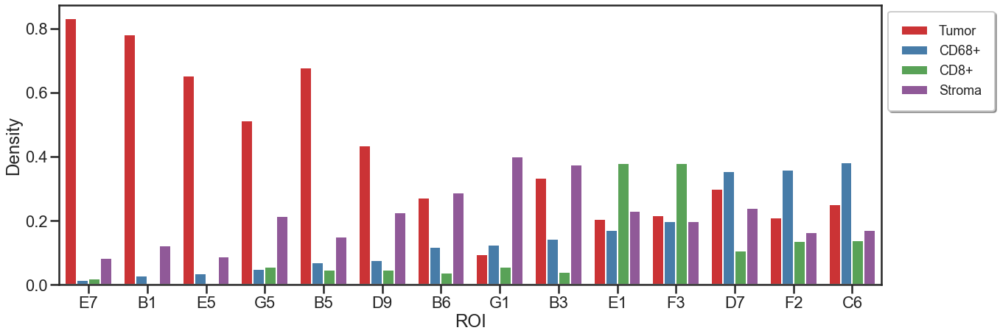

In [92]:
df_subset = df[['Tumor',  'CD68+', 'CD8+', 'Stroma']]
df_subset.sort_values('CD68+', inplace=True)
df_subset = df_subset.melt(var_name='Type', value_name='Density', ignore_index=False)
df_subset.index = df_subset.index.set_names(['ROI'])
df_subset.reset_index(inplace=True)

fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.barplot(data=df_subset, x='ROI' , y='Density', hue='Type', palette="Set1")
ax.legend(
        loc="upper left",
        bbox_to_anchor=(1.0, 1.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=18
    )

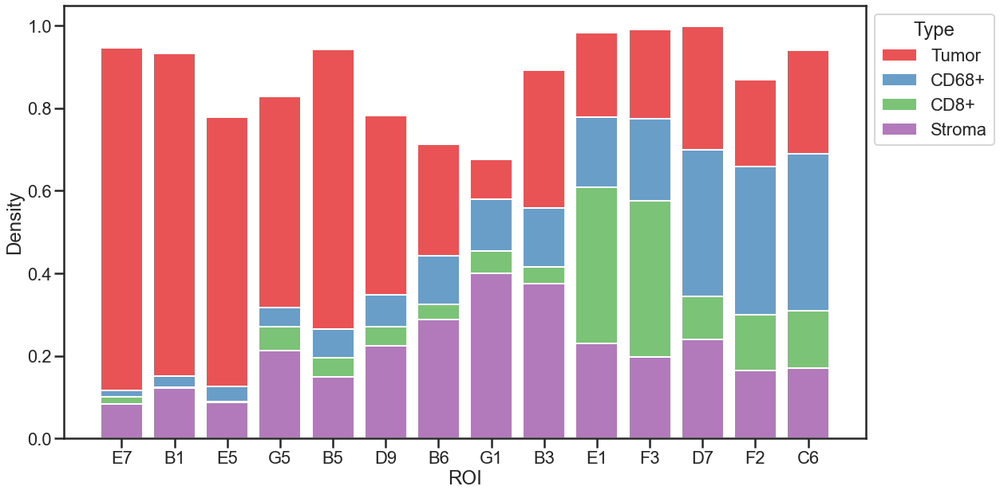

In [93]:
fig, ax = plt.subplots(figsize=(18, 10))
ax = sns.histplot(data=df_subset, x='ROI' , hue='Type', weights='Density',
             multiple='stack', palette='Set1', shrink=0.8)
ax.set_ylabel('Density')
# Fix the legend so it's not on top of the bars.
legend = ax.get_legend()
legend.set_bbox_to_anchor((1, 1))

In [94]:
# df_subset = df[['IP_T', 'IP_IP', 'IN_T', 'IN_IN']]
df_subset = df[['IP_T', 'IN_T']]
df_subset.sort_values('IP_T', inplace=True)
df_subset = df_subset.melt(var_name='Type', value_name='Score', ignore_index=False)
df_subset.index = df_subset.index.set_names(['ROI'])
df_subset.reset_index(inplace=True)

fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.barplot(data=df_subset, x='ROI' , y='Score', hue='Type', palette="Set1")
ax.legend(
        loc="upper left",
        bbox_to_anchor=(1.0, 1.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=18
    )

KeyError: "None of [Index(['IP_T', 'IN_T'], dtype='object')] are in the [columns]"

In [71]:
# df_subset = df[['IP_T', 'IP_IP', 'IN_T', 'IN_IN']]
df_subset = df[['IP_T', 'IN_T']]
df_subset.sort_values('IN_T', inplace=True)
df_subset = df_subset.melt(var_name='Type', value_name='Score', ignore_index=False)
df_subset.index = df_subset.index.set_names(['ROI'])
df_subset.reset_index(inplace=True)

fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.barplot(data=df_subset, x='ROI' , y='Score', hue='Type', palette="Set1")
ax.legend(
        loc="upper left",
        bbox_to_anchor=(1.0, 1.0),
        ncol=1,
        fancybox=True,
        framealpha=1,
        shadow=True,
        borderpad=1,
        fontsize=18
    )

KeyError: "None of [Index(['IP_T', 'IN_T'], dtype='object')] are in the [columns]"

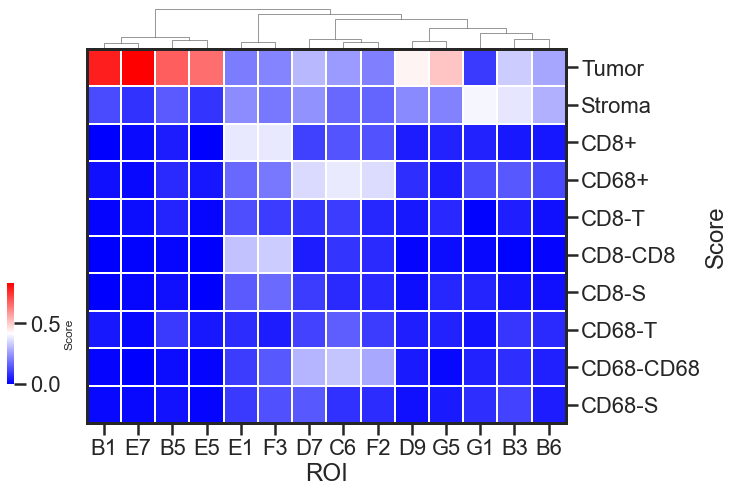

In [72]:
my_cmap = 'bwr'
scale_name = "Score"

# Clustermap
ax = sns.clustermap(
    df.T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,7),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

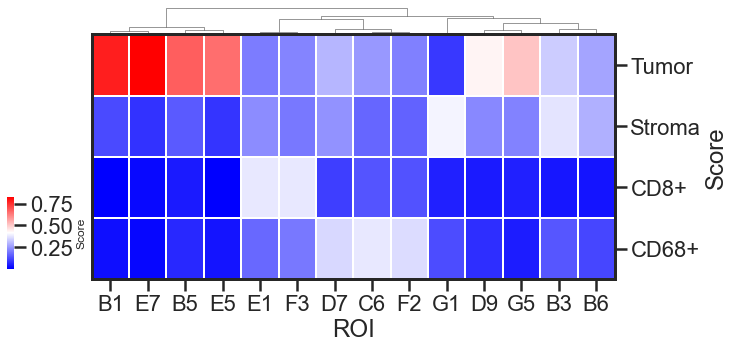

In [73]:
# Clustermap
ax = sns.clustermap(
    df.iloc[:,:4].T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,5),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

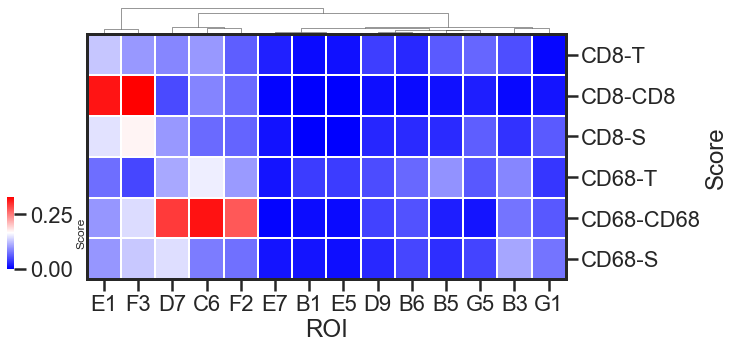

In [74]:
# Clustermap
ax = sns.clustermap(
    df.iloc[:,4:].T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,5),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

In [75]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_scaled = scaler.fit_transform(df)
df_scaled = pd.DataFrame(
    x_scaled, index=df.index, columns=df.columns
)

In [76]:
df_scaled

,Tumor,Stroma,CD8+,CD68+,CD8-T,CD8-CD8,CD8-S,CD68-T,CD68-CD68,CD68-S
B1,1.607345,-0.961785,-0.843027,-1.008849,-1.276634,-0.607185,-1.124805,-0.835006,-0.852021,-1.181054
B3,-0.341901,1.797542,-0.524021,-0.067094,-0.088321,-0.551054,-0.479736,0.511176,-0.226392,1.022958
B5,1.157620,-0.667355,-0.473915,-0.661074,0.120437,-0.508726,-0.591575,0.733685,-0.739940,-0.788815
C6,-0.701420,-0.444069,0.301051,1.861920,1.182961,0.184167,0.247215,2.385817,2.012459,0.401912
D7,-0.489195,0.319917,0.020460,1.649029,0.875177,-0.160899,0.836364,1.131420,1.773600,1.870475
D9,0.092136,0.160115,-0.470575,-0.608258,-0.372017,-0.519768,-0.629520,-0.554088,-0.529560,-0.865862
E1,-0.904493,0.214842,2.301100,0.154734,1.991229,2.317136,1.782998,0.082845,-0.027954,0.780143
B6,-0.617314,0.845295,-0.546569,-0.276734,-0.741358,-0.540012,-0.597566,-0.028410,-0.435854,-0.410584
F3,-0.849585,-0.134315,2.300265,0.376563,1.190990,2.442280,2.306243,-0.643092,0.390050,1.559952
F2,-0.880961,-0.503174,0.271823,1.690470,0.203405,0.033258,0.163336,0.864409,1.586187,0.219801


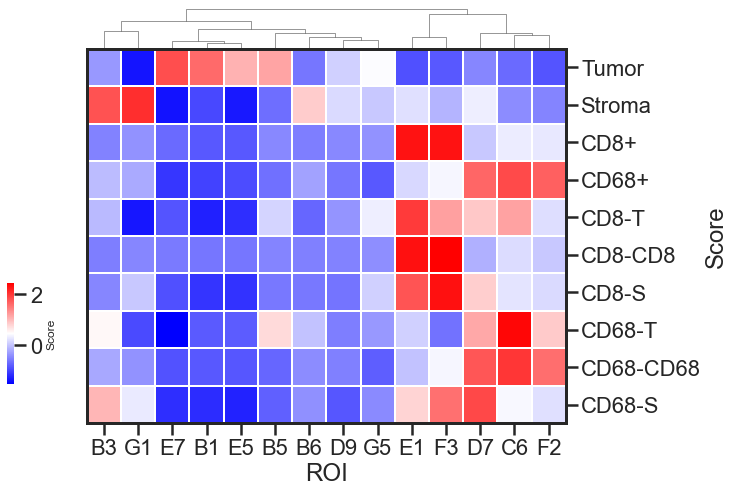

In [77]:
my_cmap = 'bwr'
scale_name = "Score"

# Clustermap
ax = sns.clustermap(
    df_scaled.T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,7),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

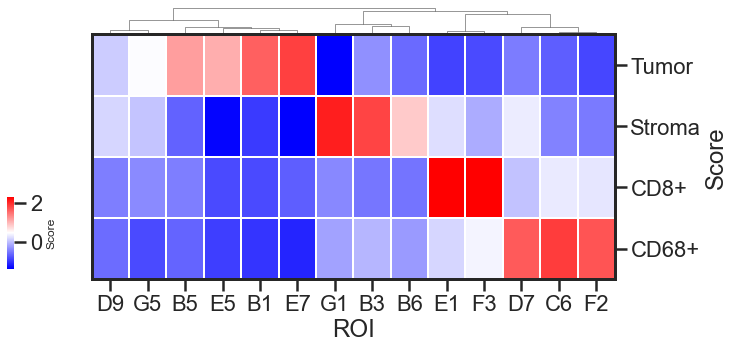

In [78]:
my_cmap = 'bwr'
scale_name = "Score"

# Clustermap
ax = sns.clustermap(
    df_scaled.iloc[:,:4].T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,5),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

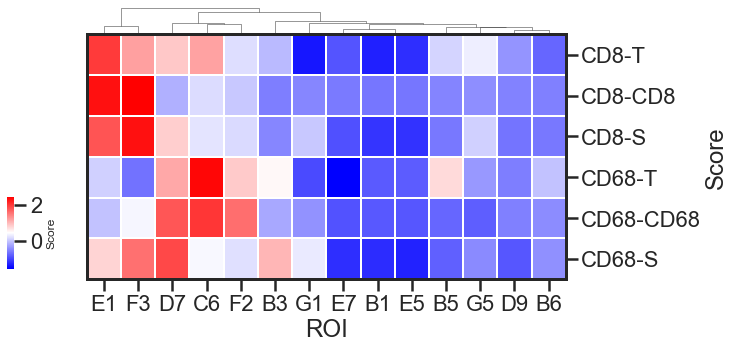

In [79]:
my_cmap = 'bwr'
scale_name = "Score"

# Clustermap
ax = sns.clustermap(
    df_scaled.iloc[:,4:].T,
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.1),
    linewidth=0.1,
    cbar_pos=(0, 0.2, 0.01, 0.2),
    figsize=(10,5),
)
ax.ax_heatmap.set_ylabel("Score")
ax.ax_heatmap.set_xlabel("ROI")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)